<a href="https://colab.research.google.com/github/ajaym416/Naamii/blob/master/cysts_detection13.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# install dependencies: 
!pip install pyyaml==5.1 pycocotools>=2.0.1
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

1.6.0+cu101 True
gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [ ]:
# install detectron2: (colab has CUDA 10.1 + torch 1.6)
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
assert torch.__version__.startswith("1.6")
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.6/index.html

In [1]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.structures import BoxMode
import skimage.draw
import math


In [ ]:
from google.colab import drive
drive.mount('/content/drive')
# drive.flush_and_unmount

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [2]:
def get_cysts_dicts(img_dir):
    # load the JSON file
    json_file = os.path.join(img_dir, "via_final.json")
    with open(json_file) as f:
        imgs_anns = json.load(f)

    dataset_dicts = []
    # loop through the entries in the JSON file
    for idx, v in enumerate(imgs_anns.values()):
        record = {}
        # add file_name, image_id, height and width information to the records
        filename = os.path.join(img_dir, v["filename"])
        # print(idx,filename)
        height, width = cv2.imread(filename).shape[:2]
        # print(height ,width)
        record["file_name"] = filename
        record["image_id"] = idx
        record["height"] = height
        record["width"] = width

        annos = v["regions"]

        objs = []
        # one image can have multiple annotations, therefore this loop is needed
        for annotation in annos:
            # reformat the polygon information to fit the specifications
            anno = annotation["shape_attributes"]
            #Since we  only have the ellipse
            # if anno["name"]== "ellipse"
            # "cx":171,"cy":227,"rx":7.6,"ry":8.158,"theta":0.197
            cx = anno["cx"]
            cy = anno["cy"]
            rx= anno["rx"]
            ry=anno["ry"]
            theta =anno["theta"]
            # px, py = skimage.draw.ellipse(cy, cx, ry, rx,rotation=theta)
            # # px, py = skimage.draw.ellipse_perimeter(cy,cx,round(ry),round(rx),orientation=theta)
            # poly = [(x + 0.5, y + 0.5) for x, y in zip(px, py)]
            # poly = [p for x in poly for p in x]

            region_attributes = annotation["region_attributes"]["Cyst-type"]

            # specify the category_id to match with the class.

            if "Giardia" in region_attributes:
                category_id = 1
            elif "Crypto" in region_attributes:
                category_id = 0
            def ellipse_to_rectange(rx,ry,theta):
              angle = theta*math.pi/180
              ea = rx*math.cos(theta)
              eb = ry*math.sin(theta)
              ec = rx*math.sin(theta)
              ed = ry*math.cos(theta)
              width = math.sqrt(math.pow(ea,2)+math.pow(eb,2))*2
              height = math.sqrt(math.pow(ec,2)+math.pow(ed,2))*2
              return (width ,height)
            width , height = ellipse_to_rectange(rx,ry,theta)

            obj = {
                # "bbox": [np.min(px), np.min(py), np.max(px), np.max(py)],
                # "bbox": [cx-rx+0.5, cy-ry+0.5, cx+rx+0.5 , cy+ry+0.5],
                "bbox": [cx-width*0.5,cy-height*0.5,cx+width*0.5,cy+height*0.5],
                "bbox_mode": BoxMode.XYXY_ABS,
                # "segmentation": [poly],
                "segmentation": [],
                "category_id": category_id,
            }
            objs.append(obj)
        record["annotations"] = objs
        dataset_dicts.append(record)

    return dataset_dicts
  
for d in ["train", "val","test"]:
    DatasetCatalog.register("cysts_" + d, lambda d=d: get_cysts_dicts("/content/drive/My Drive/Datasets/split_cysts/" + d))
    MetadataCatalog.get("cysts_" + d).set(thing_classes=["crypto" ,"Giardia"])
cysts_metadata = MetadataCatalog.get("cysts_train")

/content/drive/My Drive/Datasets/split_cysts/train/34.jpg


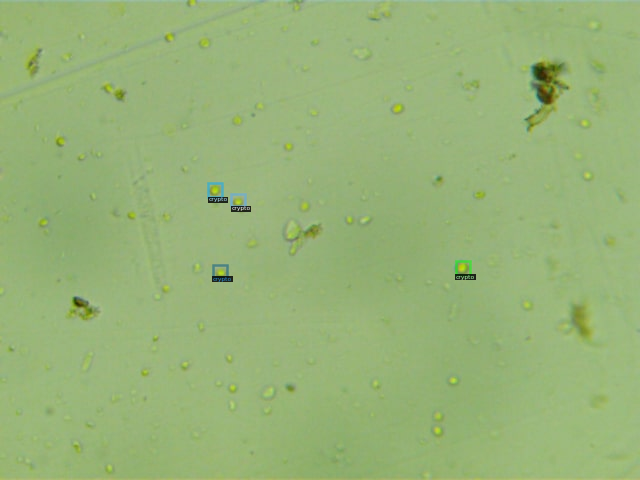

/content/drive/My Drive/Datasets/split_cysts/train/176.jpg


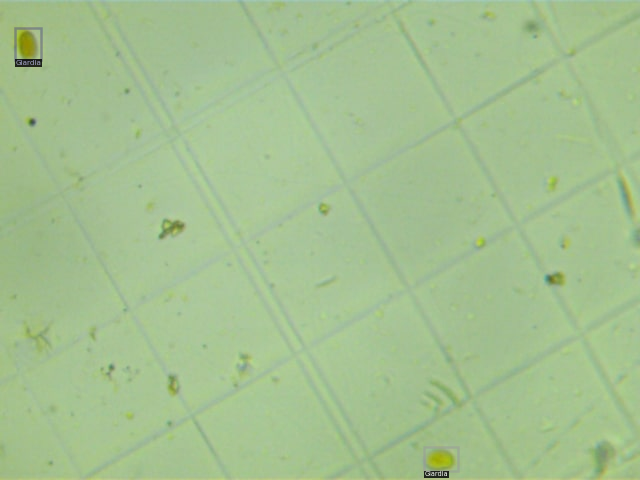

/content/drive/My Drive/Datasets/split_cysts/train/167.jpg


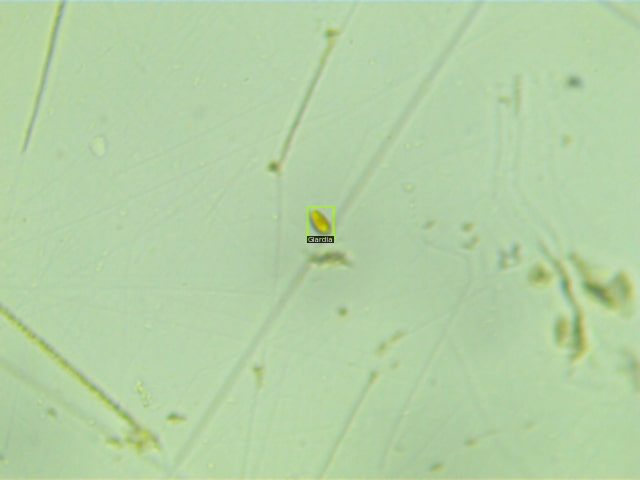

/content/drive/My Drive/Datasets/split_cysts/train/192.jpg


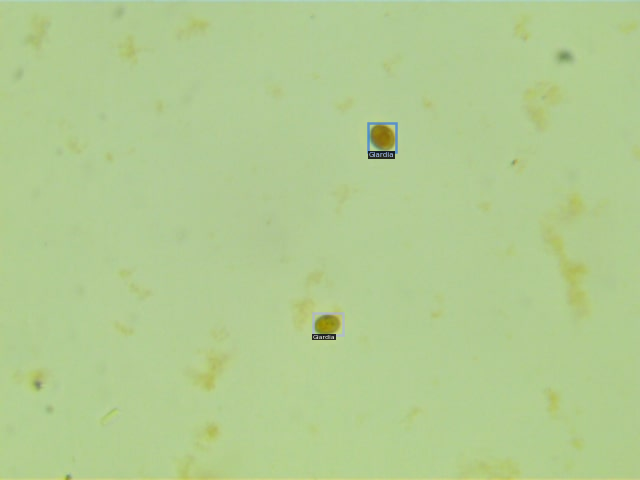

/content/drive/My Drive/Datasets/split_cysts/train/56.jpg


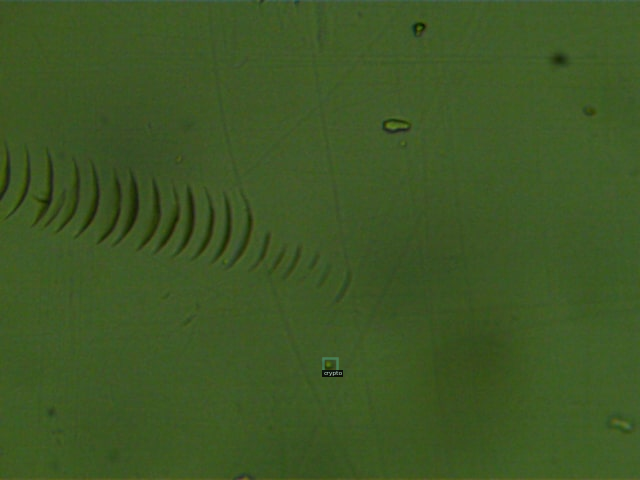

/content/drive/My Drive/Datasets/split_cysts/train/27.jpg


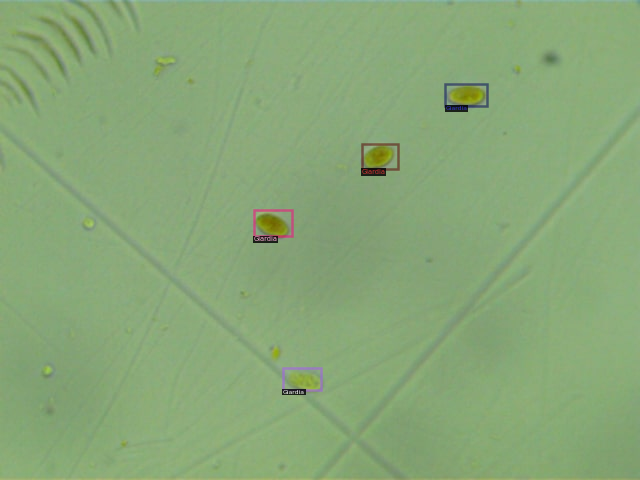

/content/drive/My Drive/Datasets/split_cysts/train/210.jpg


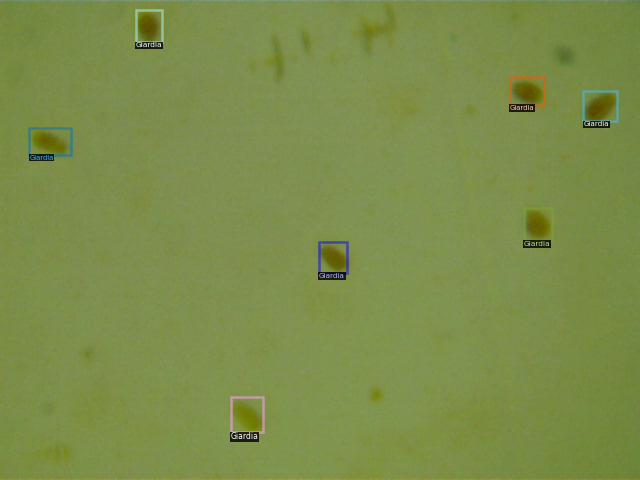

/content/drive/My Drive/Datasets/split_cysts/train/90.jpg


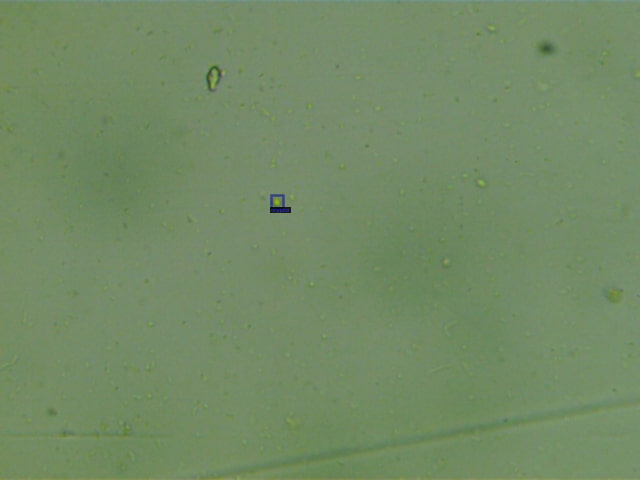

/content/drive/My Drive/Datasets/split_cysts/train/108.jpg


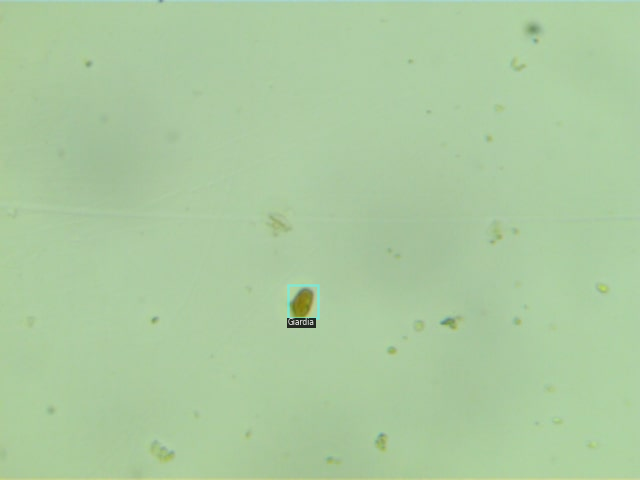

/content/drive/My Drive/Datasets/split_cysts/train/98.jpg


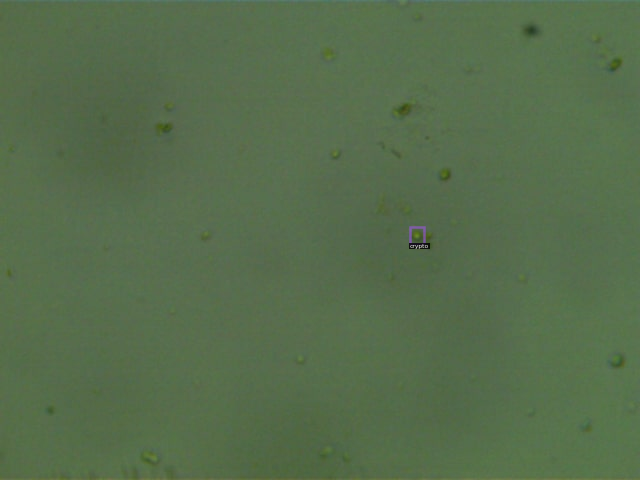

/content/drive/My Drive/Datasets/split_cysts/train/69.jpg


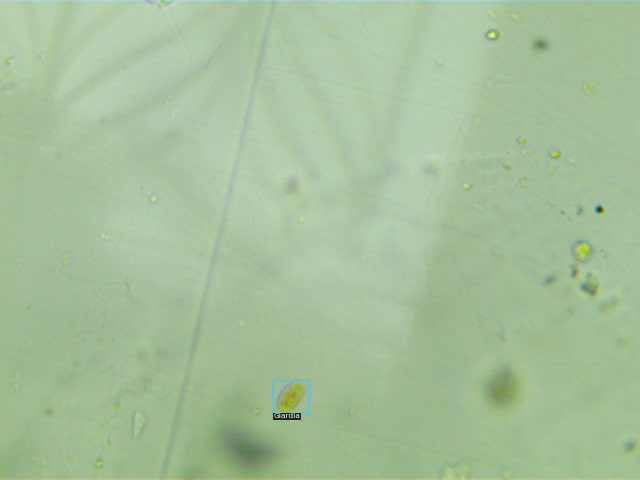

/content/drive/My Drive/Datasets/split_cysts/train/95.jpg


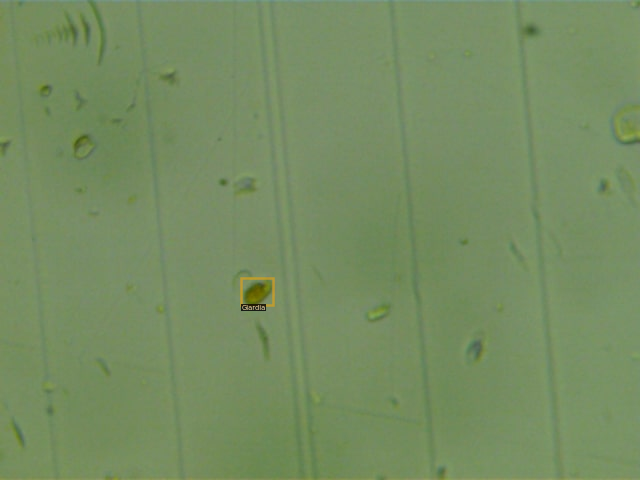

/content/drive/My Drive/Datasets/split_cysts/train/126.jpg


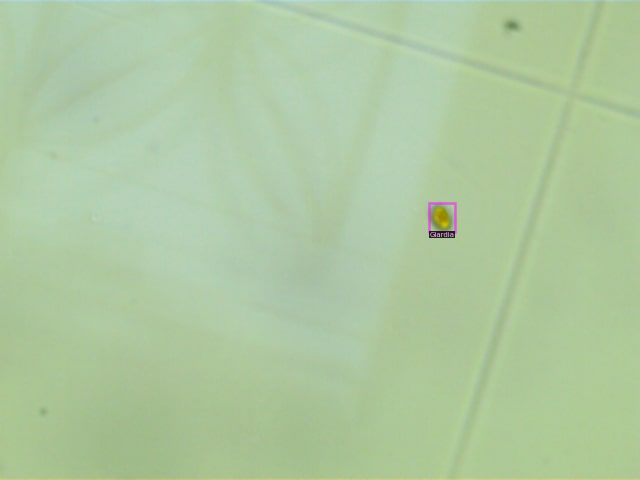

/content/drive/My Drive/Datasets/split_cysts/train/104.jpg


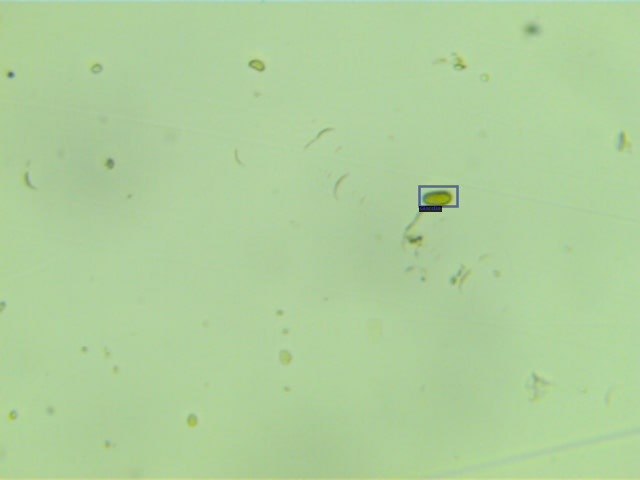

/content/drive/My Drive/Datasets/split_cysts/train/131.jpg


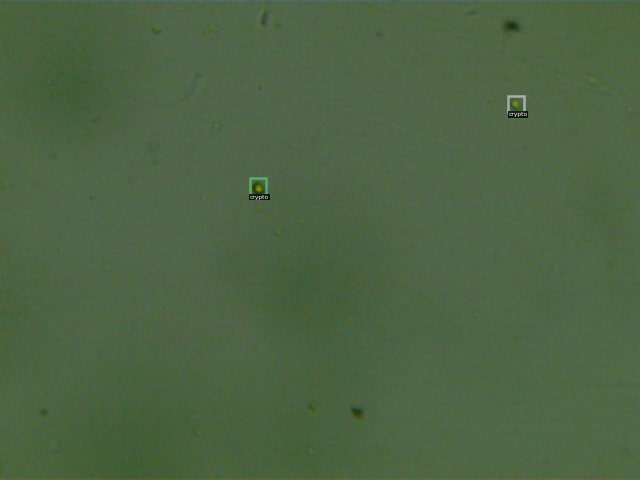

/content/drive/My Drive/Datasets/split_cysts/train/204.jpg


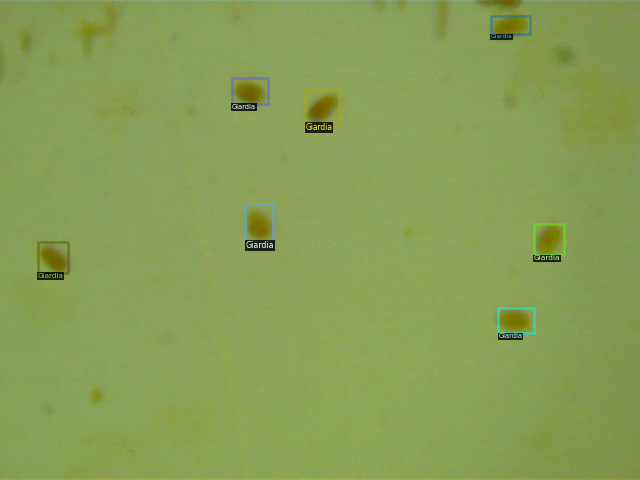

/content/drive/My Drive/Datasets/split_cysts/train/14.jpg


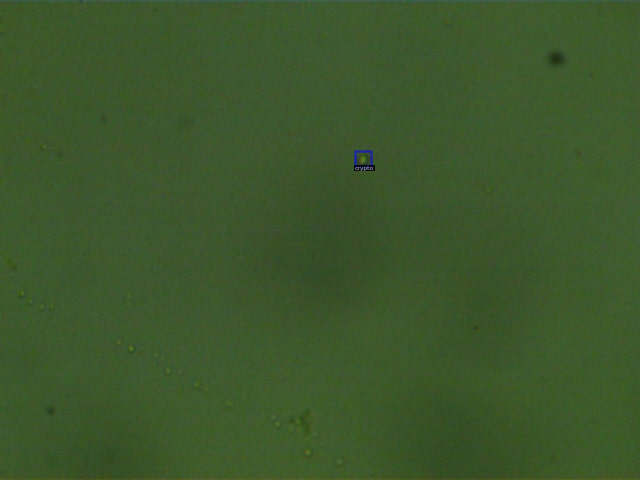

/content/drive/My Drive/Datasets/split_cysts/train/91.jpg


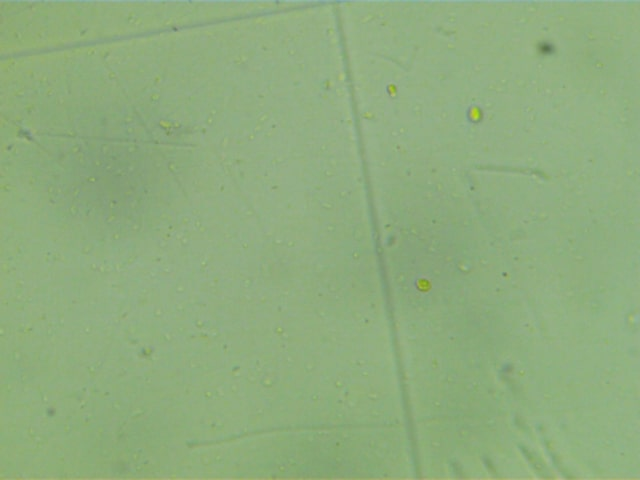

/content/drive/My Drive/Datasets/split_cysts/train/121.jpg


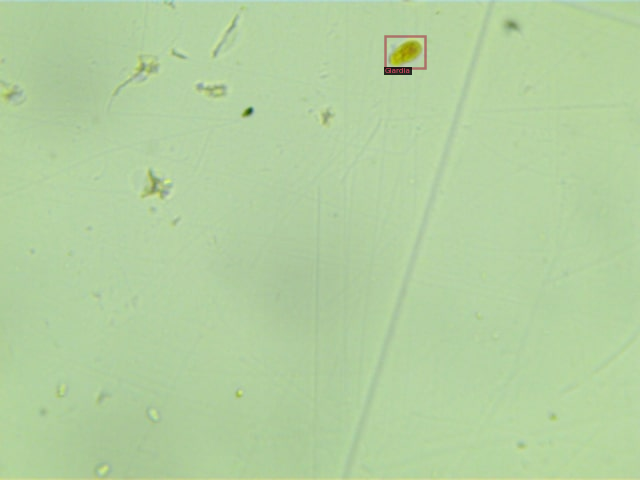

/content/drive/My Drive/Datasets/split_cysts/train/57.jpg


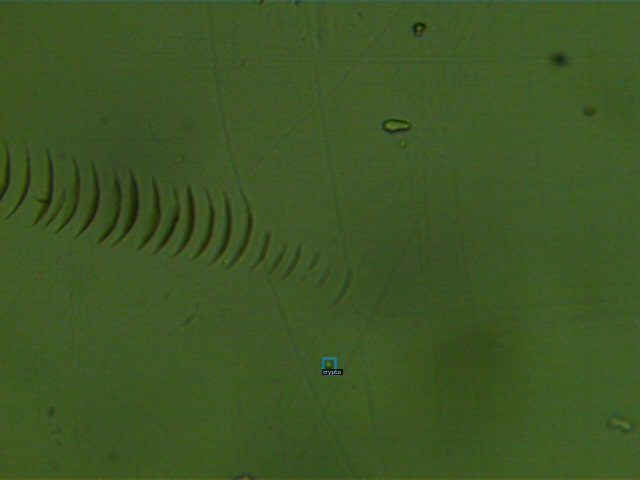

/content/drive/My Drive/Datasets/split_cysts/train/159.jpg


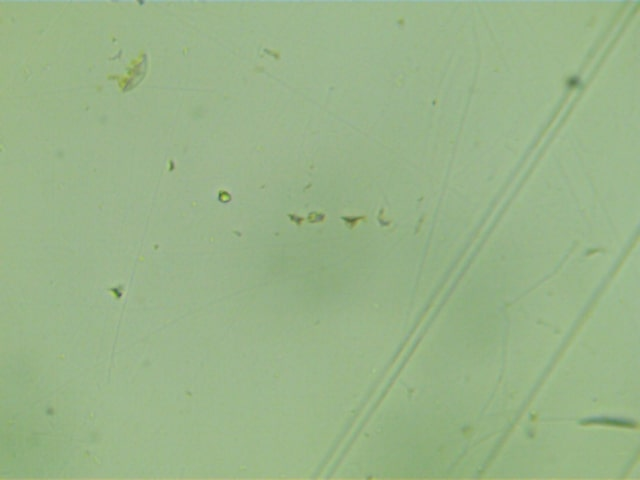

/content/drive/My Drive/Datasets/split_cysts/train/2.jpg


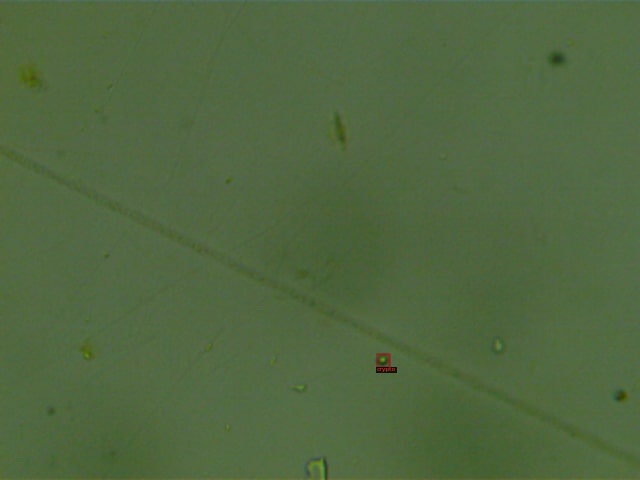

/content/drive/My Drive/Datasets/split_cysts/train/29.jpg


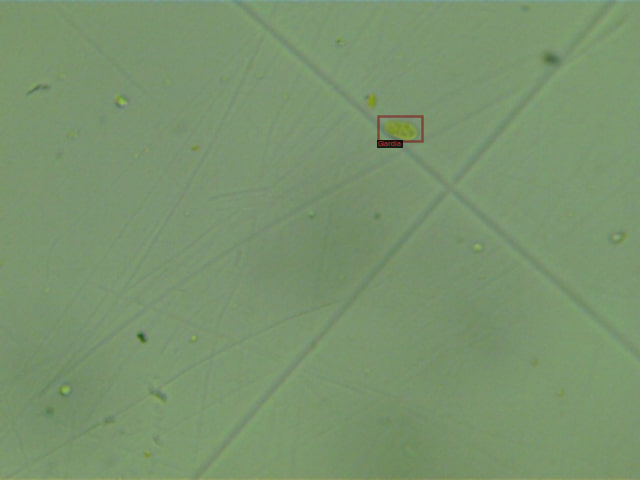

/content/drive/My Drive/Datasets/split_cysts/train/36.jpg


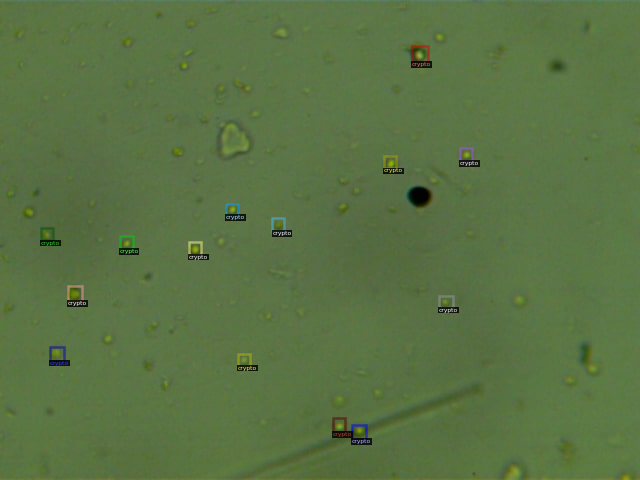

/content/drive/My Drive/Datasets/split_cysts/train/115.jpg


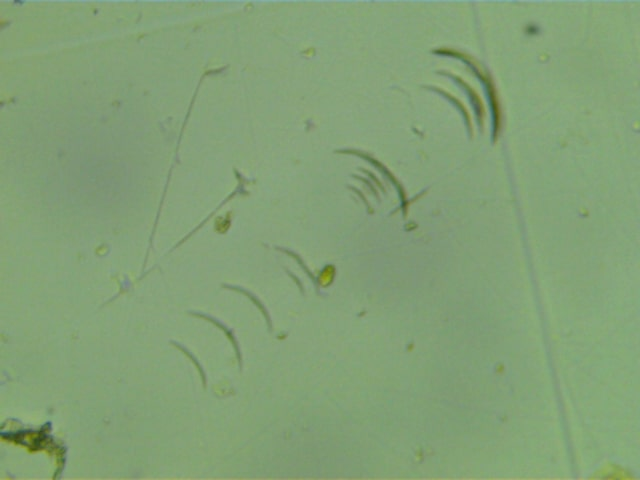

/content/drive/My Drive/Datasets/split_cysts/train/173.jpg


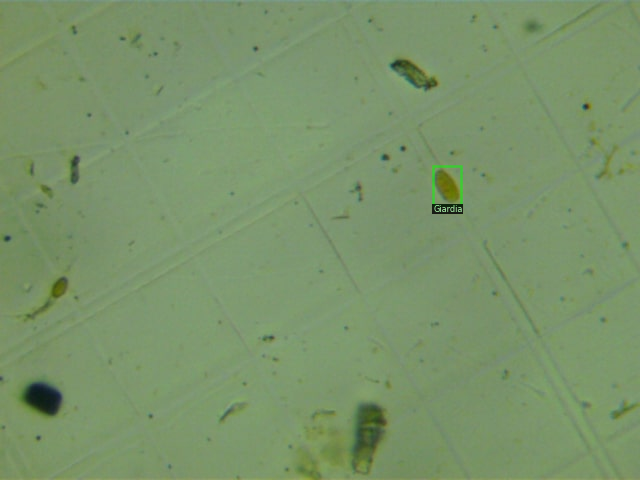

/content/drive/My Drive/Datasets/split_cysts/train/202.jpg


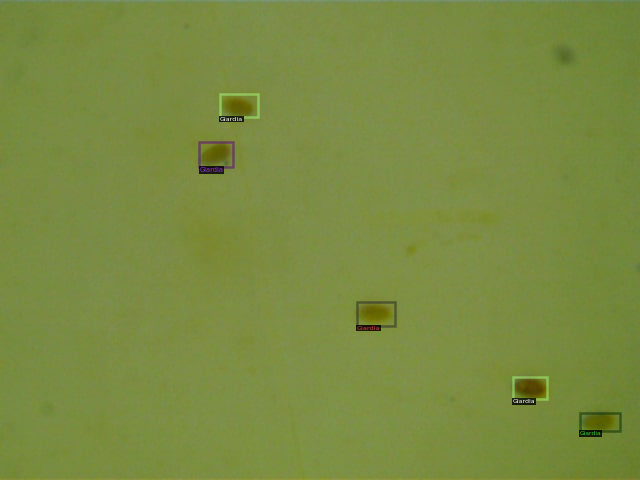

/content/drive/My Drive/Datasets/split_cysts/train/162.jpg


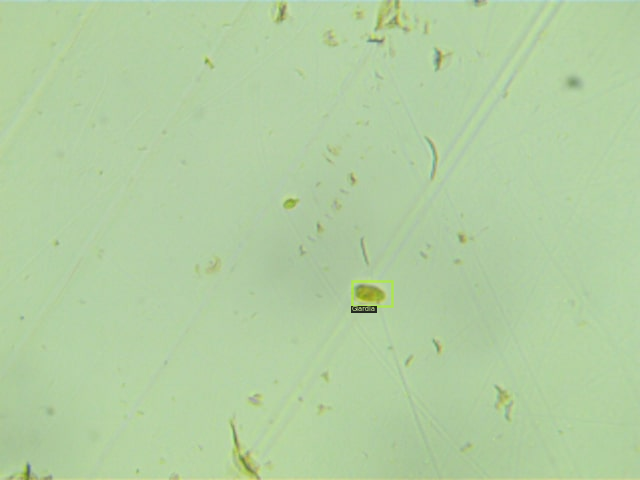

/content/drive/My Drive/Datasets/split_cysts/train/208.jpg


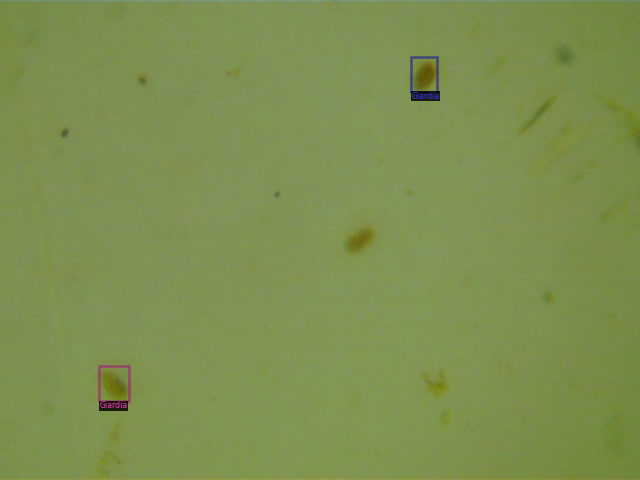

/content/drive/My Drive/Datasets/split_cysts/train/165.jpg


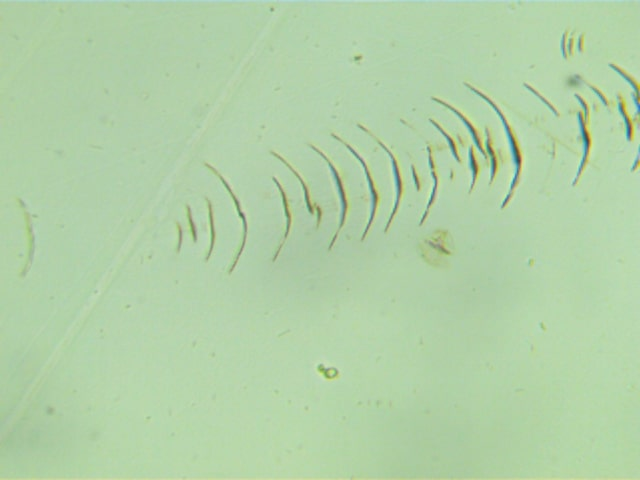

/content/drive/My Drive/Datasets/split_cysts/train/213.jpg


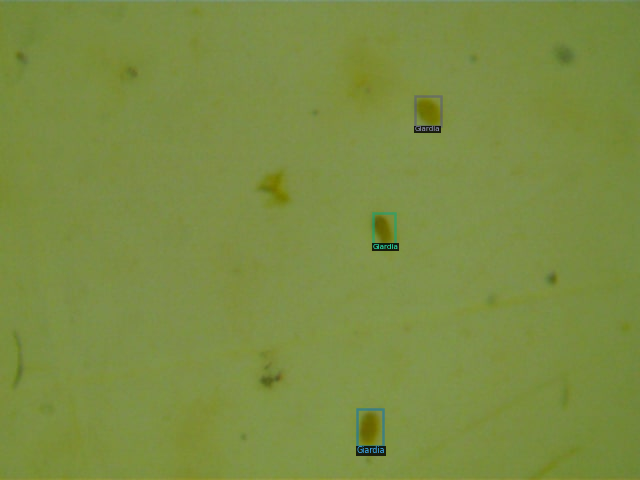

/content/drive/My Drive/Datasets/split_cysts/train/174.jpg


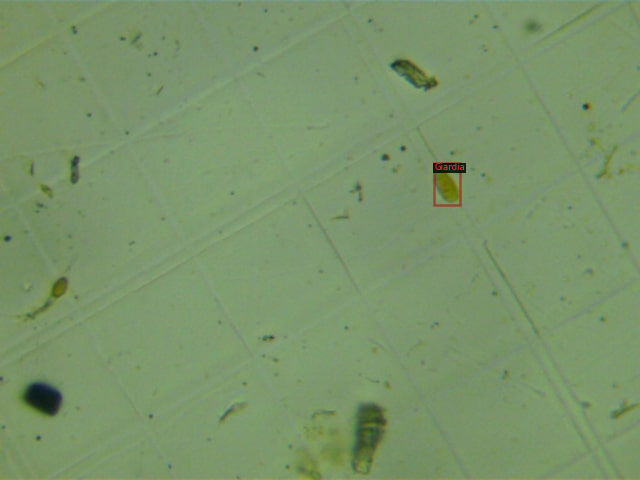

/content/drive/My Drive/Datasets/split_cysts/train/197.jpg


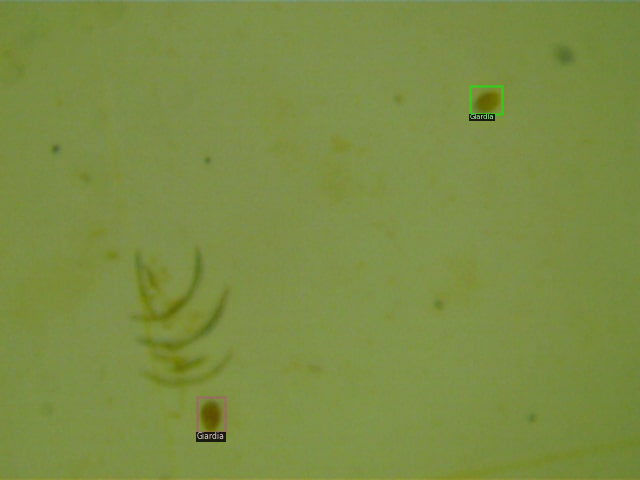

/content/drive/My Drive/Datasets/split_cysts/train/74.jpg


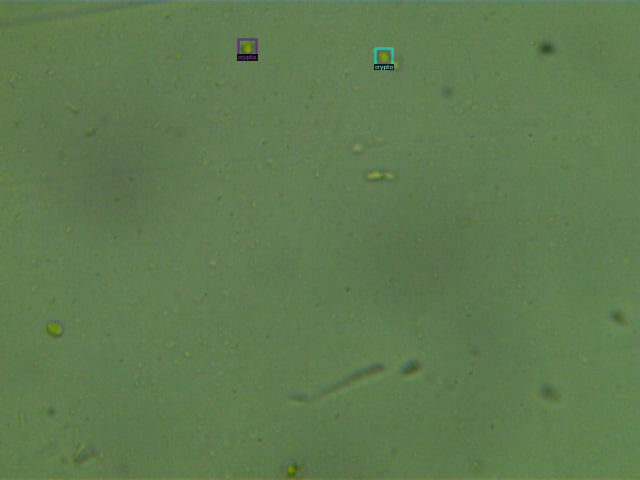

/content/drive/My Drive/Datasets/split_cysts/train/15.jpg


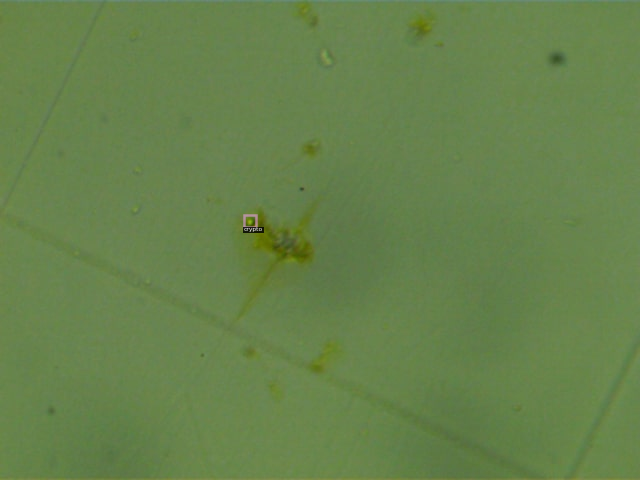

/content/drive/My Drive/Datasets/split_cysts/train/143.jpg


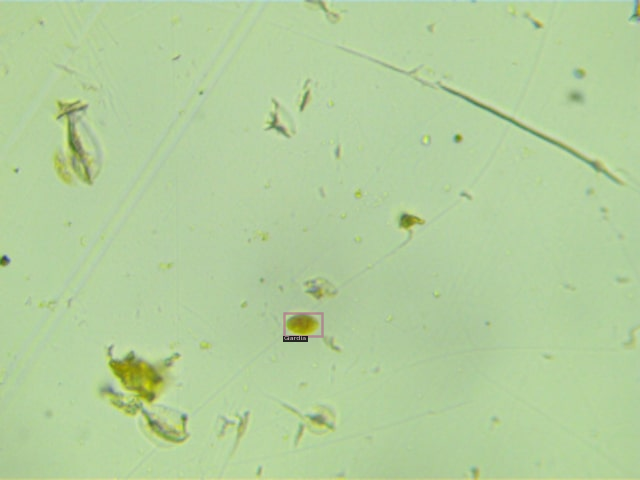

/content/drive/My Drive/Datasets/split_cysts/train/168.jpg


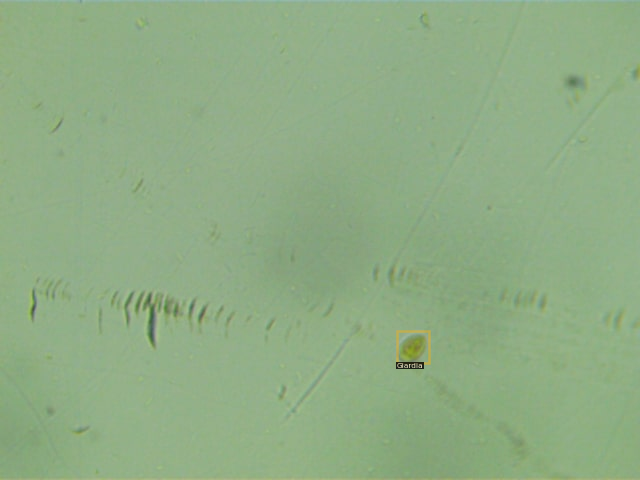

/content/drive/My Drive/Datasets/split_cysts/train/179.jpg


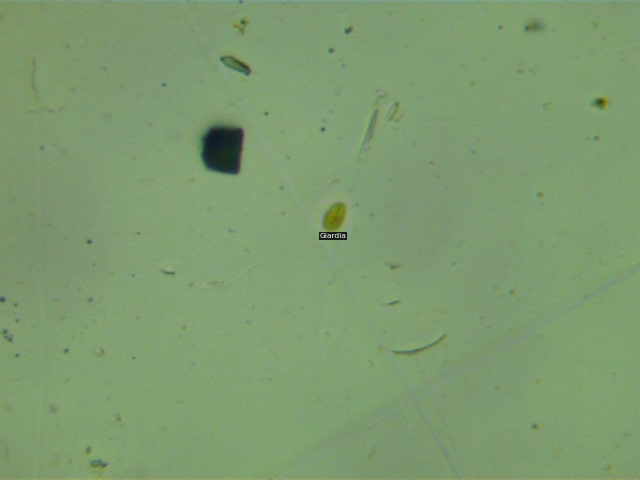

/content/drive/My Drive/Datasets/split_cysts/train/100.jpg


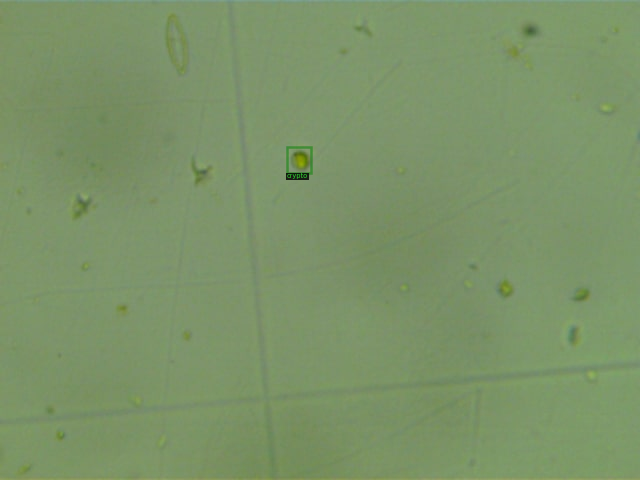

/content/drive/My Drive/Datasets/split_cysts/train/7.jpg


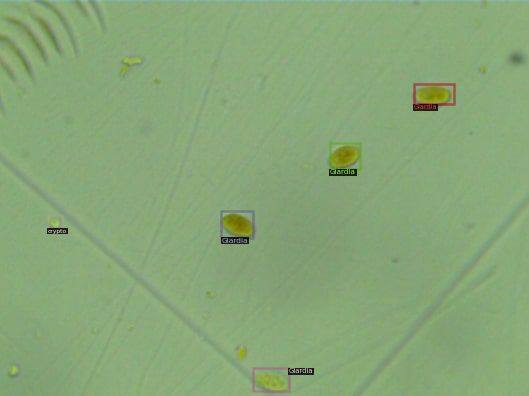

/content/drive/My Drive/Datasets/split_cysts/train/25.jpg


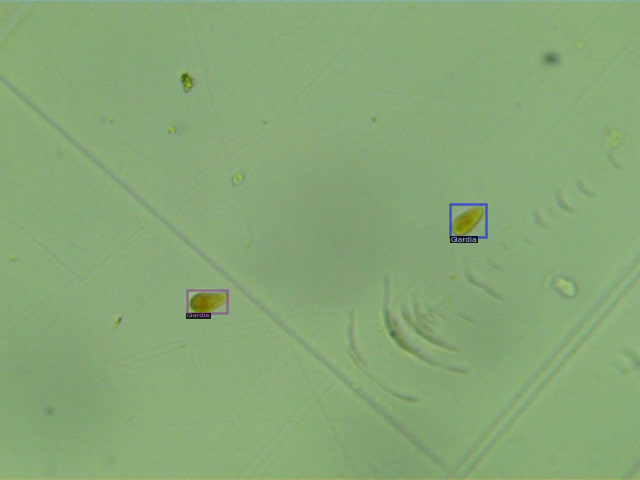

/content/drive/My Drive/Datasets/split_cysts/train/124.jpg


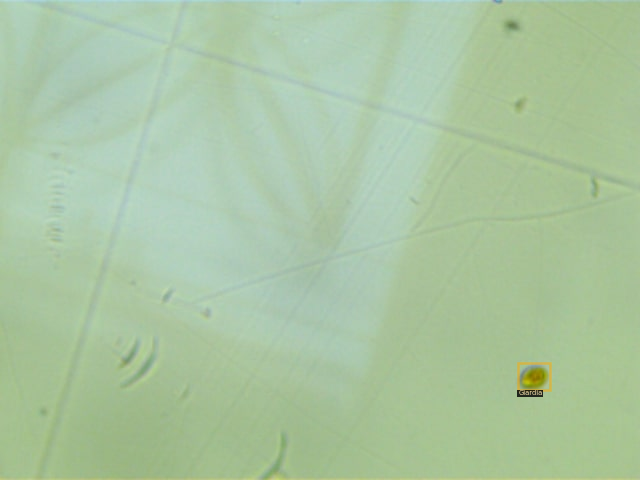

/content/drive/My Drive/Datasets/split_cysts/train/13.jpg


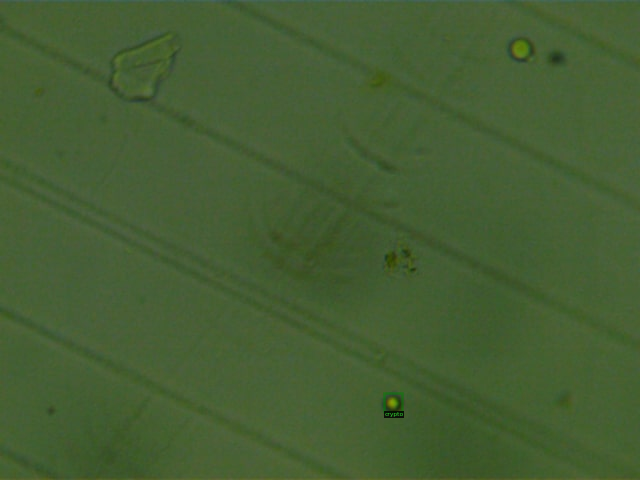

/content/drive/My Drive/Datasets/split_cysts/train/161.jpg


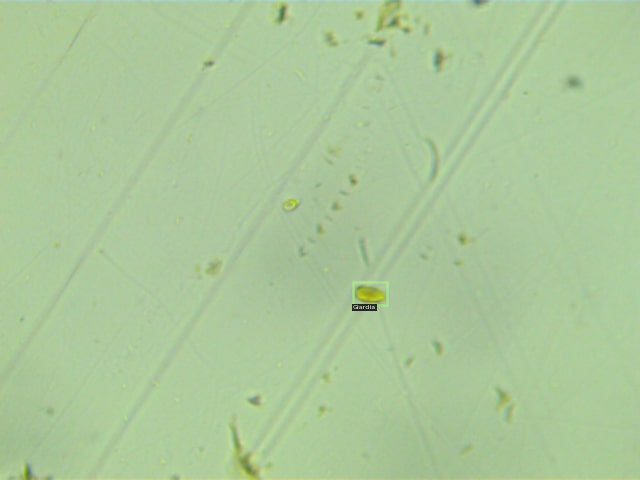

/content/drive/My Drive/Datasets/split_cysts/train/64.jpg


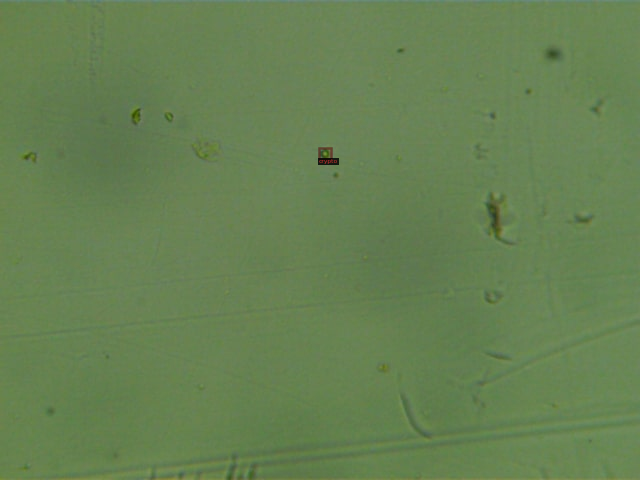

/content/drive/My Drive/Datasets/split_cysts/train/183.jpg


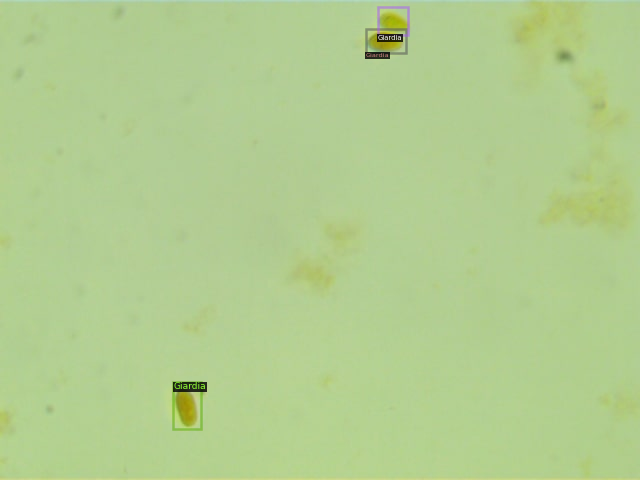

/content/drive/My Drive/Datasets/split_cysts/train/188.jpg


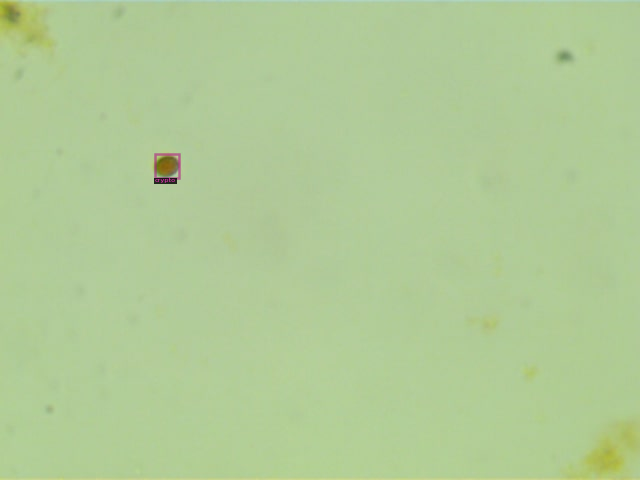

/content/drive/My Drive/Datasets/split_cysts/train/78.jpg


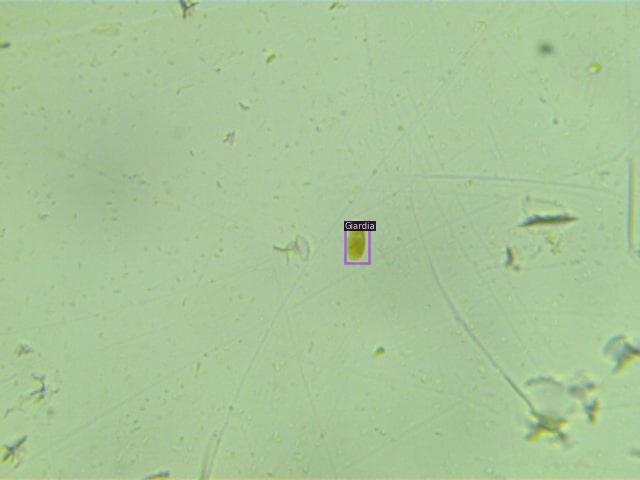

/content/drive/My Drive/Datasets/split_cysts/train/1.1.jpg


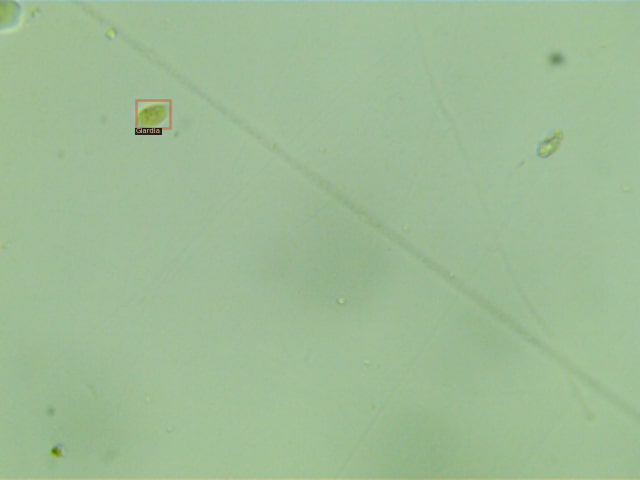

/content/drive/My Drive/Datasets/split_cysts/train/26.jpg


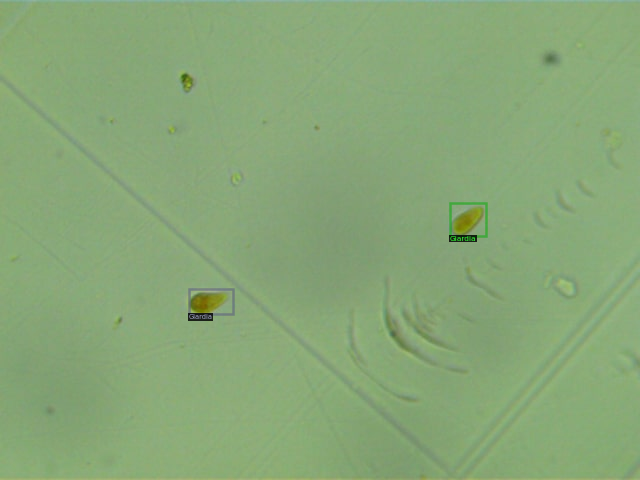

In [3]:
dataset_dicts = get_cysts_dicts("/content/drive/My Drive/Datasets/split_cysts/train")
for d in random.sample(dataset_dicts, 50):
    img = cv2.imread(d["file_name"])
    print(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=cysts_metadata, scale=1)
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
# from skimage.draw import ellipse_perimeter
# img = np.zeros((10, 10), dtype=np.uint8)
# rr, cc = ellipse_perimeter(int(2.5), 5, 3, 4)
# img[rr, cc] = 1
# img
# type(round(2.9))

int

In [4]:
from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

class CocoTrainer(DefaultTrainer):

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

In [6]:
#from .detectron2.tools.train_net import Trainer
#from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
#from detectron2.evaluation.coco_evaluation import COCOEvaluator
import os

cfg = get_cfg()
# cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml"))

cfg.DATASETS.TRAIN = ("cysts_train",)
cfg.DATASETS.TEST = ("cysts_val",)

cfg.DATALOADER.NUM_WORKERS = 4
# cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml")  # Let training initialize from model zoo

cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.001


cfg.SOLVER.WARMUP_ITERS = 200
cfg.SOLVER.MAX_ITER = 500 #adjust up if val mAP is still rising, adjust down if overfit
cfg.SOLVER.STEPS = (500, 1000)
cfg.SOLVER.GAMMA = 0.05




cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3 #your number of classes + 1

cfg.TEST.EVAL_PERIOD = 200


os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = CocoTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[08/03 13:20:08 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (4, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (4,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (12, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (12,) in the model! You might want to double check if this is expected.


[08/03 13:20:11 d2.engine.train_loop]: Starting training from iteration 0
[08/03 13:22:23 d2.utils.events]:  eta: 0:53:11  iter: 19  total_loss: 2.004  loss_cls: 1.177  loss_box_reg: 0.659  loss_rpn_cls: 0.079  loss_rpn_loc: 0.012  time: 6.5452  data_time: 0.0324  lr: 0.000096  max_mem: 10022M
[08/03 13:24:32 d2.utils.events]:  eta: 0:48:27  iter: 39  total_loss: 1.420  loss_cls: 0.536  loss_box_reg: 0.828  loss_rpn_cls: 0.005  loss_rpn_loc: 0.010  time: 6.5010  data_time: 0.0138  lr: 0.000196  max_mem: 10022M
[08/03 13:26:42 d2.utils.events]:  eta: 0:46:21  iter: 59  total_loss: 1.174  loss_cls: 0.336  loss_box_reg: 0.828  loss_rpn_cls: 0.004  loss_rpn_loc: 0.010  time: 6.5042  data_time: 0.0153  lr: 0.000296  max_mem: 10022M
[08/03 13:28:52 d2.utils.events]:  eta: 0:44:13  iter: 79  total_loss: 0.951  loss_cls: 0.186  loss_box_reg: 0.737  loss_rpn_cls: 0.001  loss_rpn_loc: 0.010  time: 6.4997  data_time: 0.0118  lr: 0.000396  max_mem: 10022M
[08/03 13:31:00 d2.utils.events]:  eta: 0:

In [7]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

Reusing TensorBoard on port 6006 (pid 1271), started 2:50:34 ago. (Use '!kill 1271' to kill it.)

<IPython.core.display.Javascript object>

In [8]:

from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
# cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "/content/drive/My Drive/checkpoint.pth")
# cfg.MODEL.WEIGHTS ="/content/drive/My Drive/models/checkpoint.pth"

cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.75
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("cysts_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "cysts_test")
inference_on_dataset(trainer.model, val_loader, evaluator)

[08/03 14:15:23 d2.evaluation.coco_evaluation]: 'cysts_test' is not registered by `register_coco_instances`. Therefore trying to convert it to COCO format ...
WARNING [08/03 14:15:23 d2.data.datasets.coco]: Using previously cached COCO format annotations at './output/cysts_test_coco_format.json'. You need to clear the cache file if your dataset has been modified.
[08/03 14:15:23 d2.data.build]: Distribution of instances among all 2 categories:
|  category  | #instances   |  category  | #instances   |
|:----------:|:-------------|:----------:|:-------------|
|   crypto   | 1            |  Giardia   | 57           |
|            |              |            |              |
|   total    | 58           |            |              |
[08/03 14:15:23 d2.data.common]: Serializing 13 elements to byte tensors and concatenating them all ...
[08/03 14:15:23 d2.data.common]: Serialized dataset takes 0.01 MiB
[08/03 14:15:23 d2.data.dataset_mapper]: Augmentations used in training: [ResizeShortestEdg

OrderedDict([('bbox',
              {'AP': 25.039302817942605,
               'AP-Giardia': 50.0786056358852,
               'AP-crypto': 0.0,
               'AP50': 47.41631305987742,
               'AP75': 27.707428637600607,
               'APl': nan,
               'APm': nan,
               'APs': 27.84576258402773})])

In [9]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.DATASETS.TEST = ("cysts_test", )
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)
test_metadata = MetadataCatalog.get("cysts_test")

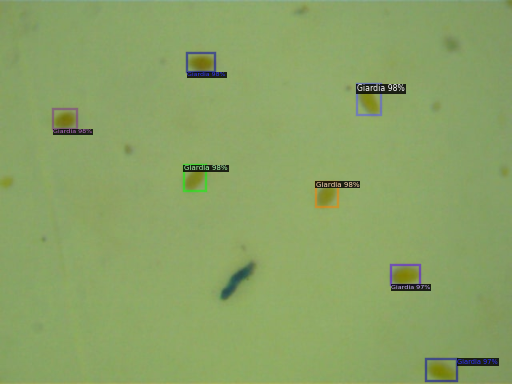

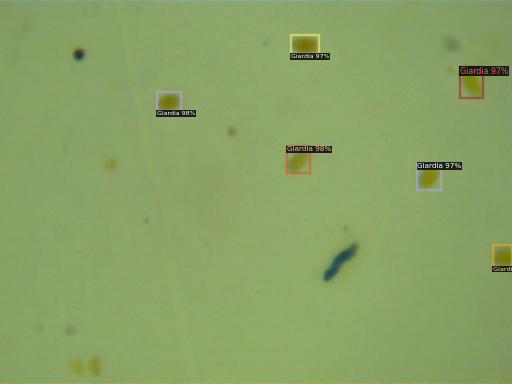

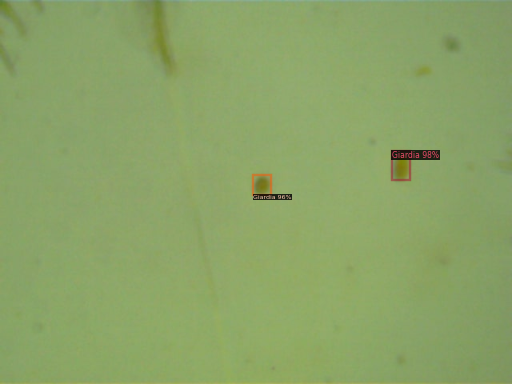

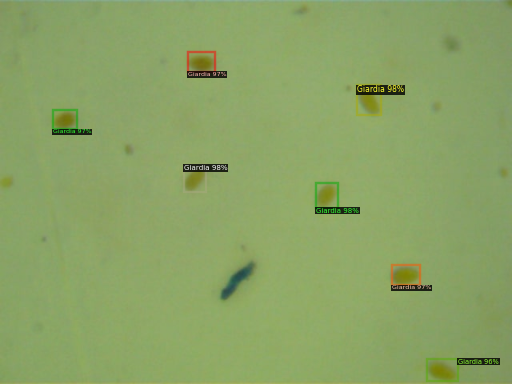

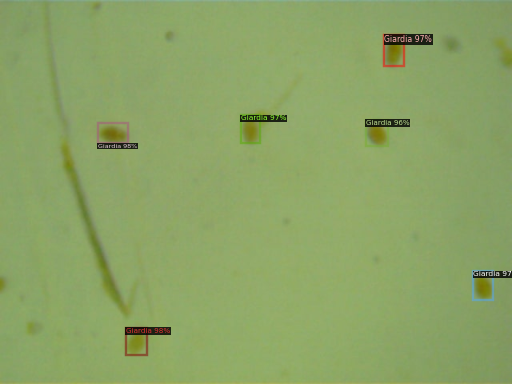

...

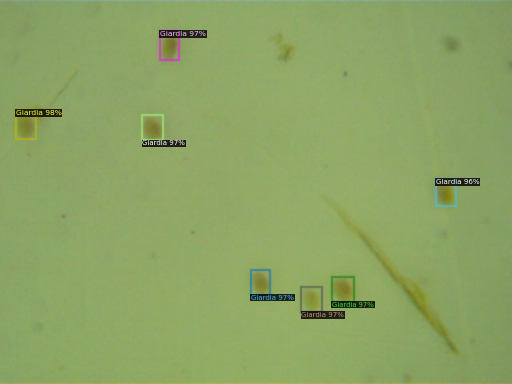

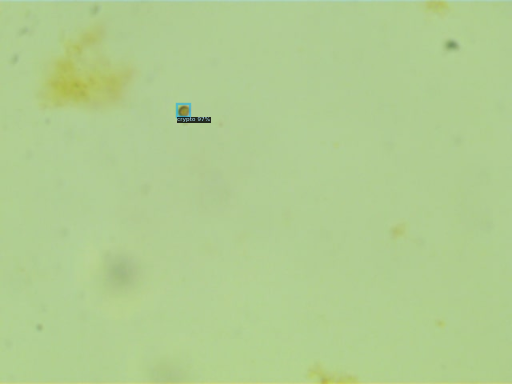

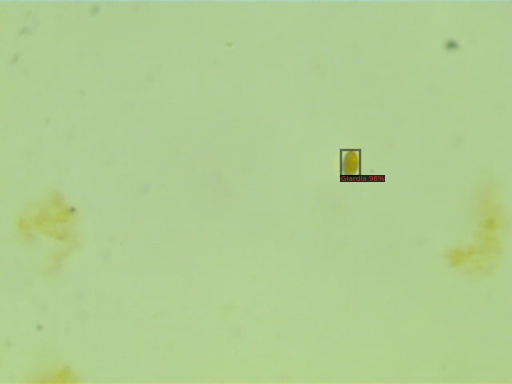

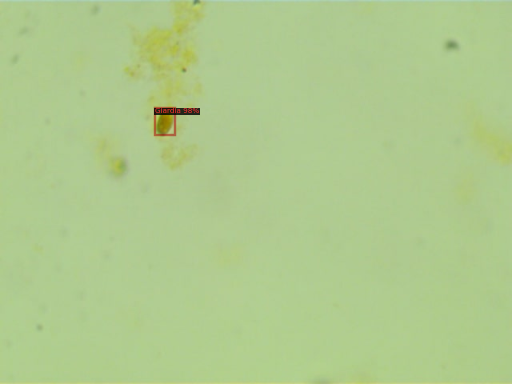

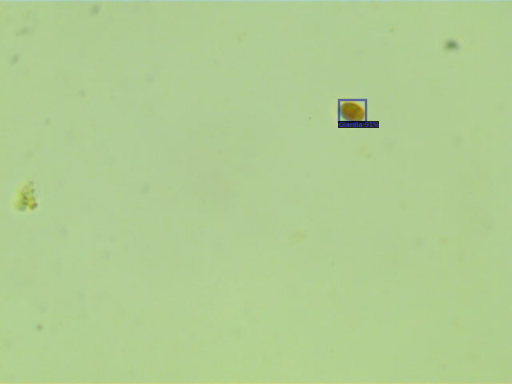

In [10]:
from detectron2.utils.visualizer import ColorMode
import glob

for imageName in glob.glob('/content/drive/My Drive/Datasets/split_cysts/val/*jpg'):
  im = cv2.imread(imageName)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata, 
                scale=0.8
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])

In [12]:
import pickle
with open("/content/drive/My Drive/Datasets/split_cysts/meta.pkl",'wb') as file:
  pickle.dump(cysts_metadata, file)



